In [1]:
import numpy as np
import scipy
import robust_mean_estimate as rl
import importlib as il
from scipy import special
from numpy import linalg as LA
import matplotlib.pyplot as plt
%matplotlib inline
import mpld3
mpld3.enable_notebook()

fsize = 20
fpad = 10
figsize = (8,4)
fontname = 'fantasy'

In [2]:
"loss, time vs dimension -- powerlaw -- dense biased -- set data"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-dimension-powerlaw.pkl'
plot_d = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_d.setdata_tofile(filename = inputfilename, xvar_name = 'd', trials = trials, xs = xs)

[[ 9.71561755 -4.62387142 -1.09960086 ...  0.0249807  -0.77159118
  -0.37385093]
 [10.80989103 -4.44842839 -1.73334388 ... -0.06073629 -0.12064991
   0.28731109]
 [ 9.00183669 -5.5778622  -2.17970196 ... -0.0650522  -0.06428354
   0.46982776]
 ...
 [ 8.3906106  -6.37682103 -3.75064234 ... -1.7568045  -1.9987356
  -1.00130743]
 [ 8.83038423 -6.87709683 -3.37738624 ... -1.47339733 -1.1902976
  -2.13301527]
 [ 7.55603495 -6.31886813 -3.35302365 ... -1.9924571  -1.35049683
  -2.10661543]]
ATTENTION
[[0.7730335209737809],[-2.1731064436090417],[-5.08541464316567],[9.872119580538957]]
[3 2 1 0]
[ 1.02220227e+01 -4.95824187e+00 -2.04109268e+00  8.53029224e-01
 -7.23924787e-06 -9.48164927e-02 -2.09591556e-02  7.23924787e-06
 -7.23924787e-06 -7.23924787e-06 -2.00675537e-01 -3.96258008e-04
 -7.23924787e-06 -1.37042633e-01  2.09591556e-02 -9.40260906e-03
 -7.23924787e-06 -7.23924787e-06  7.23924787e-06 -1.12659268e-01
 -7.23924787e-06 -6.51613077e-02 -1.17229587e-01  2.09591556e-02
 -7.06546642e-0

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:336: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


[[ 1.08509908e+01 -5.49660680e+00 -1.71841188e+00 ... -5.29532636e-01
   8.81811258e-01 -3.61266170e-01]
 [ 9.22053057e+00 -4.92012068e+00 -1.17667818e+00 ... -2.34369343e-01
   4.29066765e-01 -9.50490940e-01]
 [ 9.32895957e+00 -5.00895313e+00 -1.20881871e+00 ... -9.88818482e-01
   1.97861015e-01 -9.55111698e-04]
 ...
 [ 7.83073417e+00 -7.00018506e+00 -4.15338935e+00 ... -2.42112435e+00
  -2.30994618e+00 -2.00916428e+00]
 [ 8.82248774e+00 -7.17290757e+00 -3.38147124e+00 ... -1.82026319e+00
  -2.45944339e+00 -1.99870270e+00]
 [ 7.96948212e+00 -7.05061248e+00 -3.91864961e+00 ... -1.41353005e+00
  -2.59134896e+00 -2.95125375e+00]]
ATTENTION
[[0.8568130479752609],[-2.239728209600045],[-5.188325251253209],[9.694134486080864]]
[3 2 1 0]
[ 1.01474148e+01 -4.99687805e+00 -2.07162730e+00  9.84088732e-01
  3.76767738e-02  3.96258008e-04 -1.04928089e-01  2.09591556e-02
  7.23924787e-06 -3.96258008e-04 -8.87088180e-02 -1.35456716e-02
  1.50335979e-01 -1.71746690e-01 -2.09591556e-02 -3.96258008e-04

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

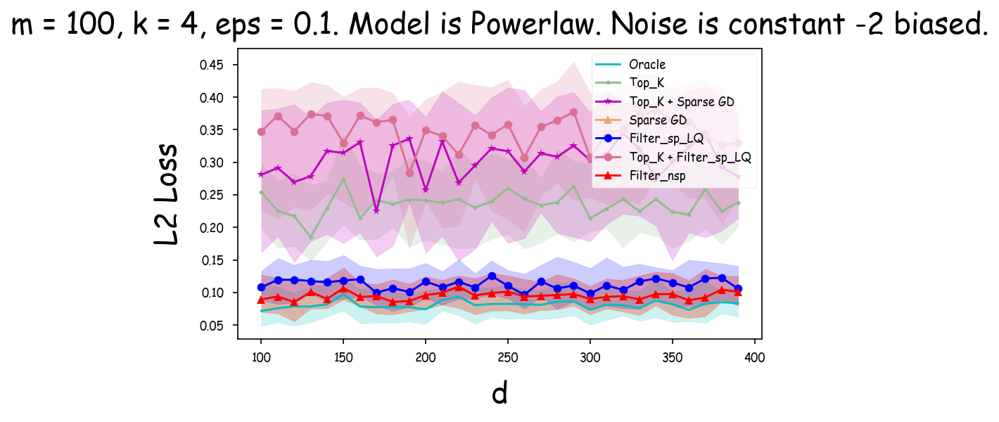

<Figure size 1200x600 with 0 Axes>

In [7]:
"loss vs dimension -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-powerlaw.pkl'
outputfilename = 'figs/loss-vs-dimension-powerlaw.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 Loss'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs dimension -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered, rl.RME_sp]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-powerlaw.pkl'
outputfilename = 'figs/loss-vs-dimension-powerlaw-detailed.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 Loss'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs dimension -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-powerlaw.pdf'
inputfilename = 'data/loss-time-vs-dimension-powerlaw.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs dimension -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-powerlaw-detailed.pdf'
inputfilename = 'data/loss-time-vs-dimension-powerlaw.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [3]:
"loss, time vs sparsity -- powerlaw -- dense biased -- set data"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)

inputfilename = 'data/loss-time-vs-sparsity-powerlaw.pkl'
plot_k = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_k.setdata_tofile(filename = inputfilename, xvar_name = 'k', trials = trials, xs = xs)

[[ 1.2325847   0.00315492  0.99449262 ...  0.35447157  0.97089345
   0.5274097 ]
 [ 1.04846251  1.892485    0.98981157 ...  0.00731819  0.92617197
  -0.0479265 ]
 [ 1.42575843  1.23901843  0.16983596 ...  0.69460534  0.12126884
  -0.75913806]
 ...
 [ 0.71507157  0.6448463   0.85838732 ... -0.42835258 -0.68731863
   0.73532151]
 [ 0.61159134  0.83625792  0.6069168  ... -0.29942232 -0.24010861
  -0.68340226]
 [ 1.40503524  0.79411681  0.87786166 ...  0.77066435  0.07288167
  -1.00281035]]
ATTENTION
[[0.9461547251575213],[0.9459651434397449],[0.9529808843006058],[1.020933763536494]]
[1 0 2 3]
[ 9.13216761e-01  8.98610583e-01  9.58120592e-01  9.97916656e-01
  0.00000000e+00 -5.41460901e-05 -5.41460901e-05 -7.23924787e-06
 -2.88756694e-03 -8.92229129e-02 -7.23924787e-06 -2.88756694e-03
 -2.88756694e-03 -3.96258008e-04 -5.41460901e-05  0.00000000e+00
  2.00325726e-03  7.23924787e-06  0.00000000e+00 -1.38747890e-02
  7.23924787e-06  1.71905438e-02 -5.41460901e-05 -4.20998021e-02
  1.03622772e

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Quadratic filter...
Filtered out 0/200, 0.0 false (nan vs 0.1)
condition 200 200
Could not filter
RME exited properly
[[ 1.69496762  1.74811498  0.96110258 ... -0.19591247 -0.20376792
   0.19283676]
 [ 0.8491825   1.5161587   0.03974652 ...  0.38505867 -0.02024419
  -0.79542932]
 [ 1.76474985  1.00158873  0.41065178 ... -0.90900387  0.21180053
   0.19623563]
 ...
 [ 0.7732191   1.47470944  0.62349193 ...  0.5462092  -0.83781566
  -0.00474346]
 [ 1.69486436  0.80214402  0.63177534 ... -0.73973411 -0.12296387
   0.37680416]
 [ 1.31011165  0.82096546  0.62769052 ... -0.61157631 -0.19286458
  -0.67475228]]
ATTENTION
[[0.9309966069148063],[0.9845212857565531],[0.9704888689498896],[0.9417470089194521],[0.9925403186847147],[1.0405382812819224],[0.9685538327727494],[1.0040368952774634]]
[4 7 2 3 1 5 6 0]
[ 1.00267776e+00  9.54060555e-01  9.67958140e-01  9.57934984e-01
  9.41947021e-01  1.00540782e+00  9.97487359e-01  9.42341436e-01
 -5.41460901e-05  0.00000000e+00 -3.96258008e-04  3.96258008e-

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

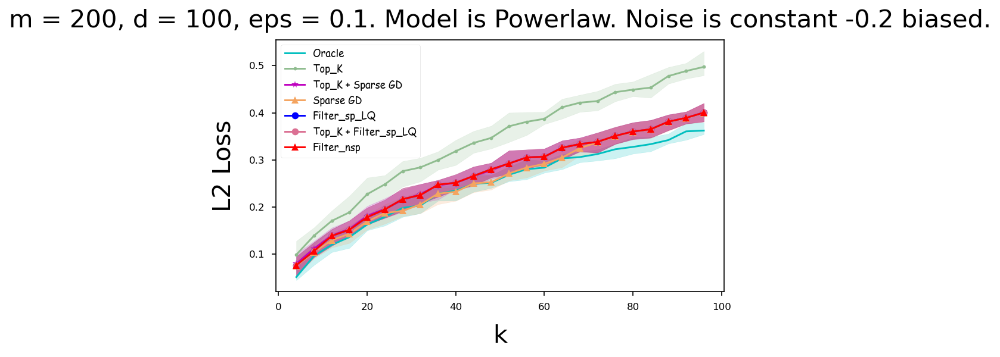

<Figure size 1200x600 with 0 Axes>

In [6]:
"loss vs sparsity -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-powerlaw.pkl'
outputfilename = 'figs/loss-vs-sparsity-powerlaw.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Powerlaw. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 Loss'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs sparsity -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-powerlaw.pkl'
outputfilename = 'figs/loss-vs-sparsity-powerlaw-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Powerlaw. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 Loss'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sparsity -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-powerlaw.pkl'
outputfilename = 'figs/time-vs-sparsity-powerlaw.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Powerlaw. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sparsity -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-powerlaw.pkl'
outputfilename = 'figs/time-vs-sparsity-powerlaw-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Powerlaw. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [4]:
"loss, time vs sample -- powerlaw -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-sample-powerlaw.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'd', trials = trials, xs = xs)

[[ 9.76304494e+00 -4.63776688e+00 -2.68618351e+00 ...  1.53058951e-04
   1.08643610e-01  4.17817623e-02]
 [ 9.10758976e+00 -4.18748007e+00 -1.17403372e+00 ... -3.70686012e-01
  -3.21257791e-01  9.44633005e-02]
 [ 1.00029154e+01 -4.25178730e+00 -2.55675812e+00 ...  3.61403903e-01
   3.65260780e-01 -3.64580579e-01]
 ...
 [ 8.41890668e+00 -6.98818309e+00 -4.28957513e+00 ... -1.93303843e+00
  -1.88396379e+00 -1.81550166e+00]
 [ 7.79674858e+00 -7.63345390e+00 -4.33120064e+00 ... -1.97948703e+00
  -1.83618505e+00 -1.77263484e+00]
 [ 7.94976011e+00 -7.29204320e+00 -3.98503440e+00 ... -1.03485802e+00
  -1.88372408e+00 -1.72524917e+00]]
ATTENTION
[[0.7953086224163368],[-2.203151537987189],[-5.175456882821959],[9.792791414361668]]
[3 2 1 0]
[ 1.02212438e+01 -5.00633821e+00 -2.07590784e+00  9.38596149e-01
 -3.47086748e-03 -1.78840842e-04 -8.06563523e-05 -8.77417592e-04
 -3.96258008e-04 -3.63352618e-05  1.63198578e-05  8.21438980e-07
 -7.23924787e-06 -1.83168756e-02  3.01675195e-06 -7.23924787e-06

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Linear filter...
Filtered out 17/500, 0.0 false (0.00 vs 0.1)
Quadratic filter...
Filtered out 0/483, 0.0 false (nan vs 0.1)
condition 483 483
Could not filter
Linear filter...
Filtered out 50/500, 0.0 false (0.00 vs 0.1)
RME exited properly
[[10.53894318 -5.07317465 -1.14936709 ... -0.90171587 -0.01255868
   0.50440175]
 [ 9.99755823 -4.26489151 -2.48672694 ...  0.20891002 -0.25929074
   0.78240383]
 [ 9.22844861 -4.64379774 -1.21819742 ...  0.43373768  0.34090569
  -0.40887673]
 ...
 [ 7.1214902  -6.97597393 -3.56823917 ... -1.87267378 -2.82342224
  -1.2221792 ]
 [ 8.01538575 -6.88639892 -3.66725315 ... -1.39706968 -2.09994052
  -2.46846772]
 [ 8.58883509 -7.39237932 -4.12476238 ... -1.37528432 -1.89843752
  -2.28143001]]
ATTENTION
[[0.8960978598716964],[-2.1359134902296235],[-5.162016196635349],[9.867677421669237]]
[3 2 1 0]
[ 1.02274143e+01 -5.10597526e+00 -2.01535913e+00  9.63566341e-01
 -8.21438980e-07 -1.63198578e-05 -3.63352618e-05 -7.23924787e-06
 -3.63352618e-05  3.01675195e-

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:336: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


[[ 9.75765565 -4.13936267 -2.21643631 ...  0.17625151  0.8430372
  -0.48573978]
 [ 9.26156785 -5.80863148 -2.77602848 ...  0.09055275 -0.32069189
   0.83596123]
 [ 9.96292588 -5.02732778 -2.72401798 ... -0.43365471 -0.9627937
  -0.13142067]
 ...
 [ 8.13200941 -7.6451095  -3.250186   ... -2.44473795 -1.69997095
  -1.99389092]
 [ 7.32302546 -7.65776685 -4.55687331 ... -1.05520664 -1.30752703
  -1.00276378]
 [ 7.92712711 -6.99560761 -4.00730911 ... -2.66405581 -1.48008568
  -1.32436089]]
ATTENTION
[[0.8669695205889669],[-2.152548520310669],[-5.154178118993213],[9.852878779766243]]
[3 2 1 0]
[ 1.02907551e+01 -5.00835934e+00 -2.02667926e+00  9.89596066e-01
 -1.63198578e-05 -4.22538350e-02 -3.28034215e-02 -1.63198578e-05
  7.23924787e-06 -5.61479165e-02 -2.73527257e-03 -3.96258008e-04
 -1.63198578e-05 -3.63352618e-05 -3.66533876e-04 -8.77417592e-04
 -3.01675195e-06 -1.63198578e-05 -2.20607291e-02 -8.08434293e-03
 -3.01675195e-06 -1.78840842e-04 -1.63198578e-05 -1.63198578e-05
 -1.78840842e-0

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

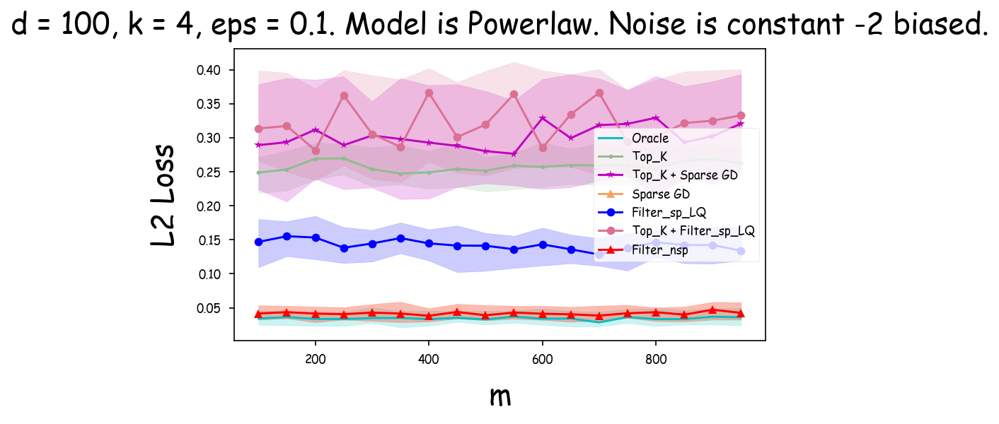

<Figure size 1200x600 with 0 Axes>

In [8]:
"loss vs sample -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-powerlaw.pkl'
outputfilename = 'figs/loss-vs-sample-powerlaw.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 Loss'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs sample -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered, rl.RME_sp]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-powerlaw.pkl'
outputfilename = 'figs/loss-vs-sample-powerlaw-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 Loss'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sample -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-powerlaw.pkl'
outputfilename = 'figs/time-vs-sample-powerlaw.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sample -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-powerlaw.pkl'
outputfilename = 'figs/time-vs-sample-powerlaw-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Powerlaw. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [5]:
"loss, time vs eps -- powerlaw -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)

inputfilename = 'data/loss-time-vs-eps-powerlaw.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'eps', trials = trials, xs = xs)

[[ 1.07682882e+01 -4.99926085e+00 -1.42743056e+00 ... -9.61466514e-01
  -4.91672481e-01 -6.92318436e-01]
 [ 1.00916020e+01 -5.61596178e+00 -1.22739114e+00 ... -1.01018798e-01
   4.13413697e-01  7.57615213e-03]
 [ 1.03471561e+01 -5.23376258e+00 -1.41470545e+00 ... -1.29048298e-01
   5.19470481e-01 -2.09218234e-01]
 ...
 [ 8.14681832e+00 -6.16259338e+00 -4.45150847e+00 ... -2.13258752e+00
  -2.01677904e+00 -2.03992569e+00]
 [ 8.43487905e+00 -7.01725726e+00 -3.87328016e+00 ... -2.38117411e+00
  -2.63511275e+00 -1.59506917e+00]
 [ 7.91088340e+00 -6.99843464e+00 -3.48930526e+00 ... -1.65095962e+00
  -1.80997199e+00 -2.70741318e+00]]
ATTENTION
[[0.9731445770703994],[-2.015579188466168],[-5.0105357416597975],[9.9913489909836]]
[3 2 1 0]
[ 1.04222436e+01 -4.98276946e+00 -1.99639926e+00  9.89359195e-01
  3.52693751e-06 -1.11779977e-06 -1.43399846e-06  3.01675195e-06
 -1.43399846e-06 -1.11779977e-06 -8.21438980e-07 -4.09966165e-06
  4.09966165e-06 -3.52693751e-06 -5.37303221e-05 -2.78411928e-05


/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Quadratic filter...
Filtered out 0/3000, 0.0 false (nan vs 0.1)
condition 3000 3000
Could not filter
Linear filter...
Filtered out 30/3000, 0.0 false (0.00 vs 0.1)
RME exited properly
[[10.84018137 -5.25267417 -2.04246703 ...  0.06923309  0.87959635
  -0.68468362]
 [ 9.95870051 -5.37282932 -1.92827703 ... -0.93336438 -0.04741305
  -0.35008316]
 [10.00275868 -5.1199723  -1.73112479 ... -0.73196766  0.58359278
  -0.0724662 ]
 ...
 [ 8.01875341 -6.16876811 -3.70985204 ... -1.93074024 -1.21008991
  -1.99166337]
 [ 7.30022365 -7.01887638 -4.32683685 ... -2.19739629 -1.06461282
  -2.39565407]
 [ 8.79843489 -7.53943131 -3.08810467 ... -1.89038545 -1.80680767
  -2.0485054 ]]
ATTENTION
[[0.9665034835625403],[-2.030176170452988],[-5.020935389756261],[9.975553276843574]]
[3 2 1 0]
[ 1.04010970e+01 -4.98472285e+00 -1.99982469e+00  9.79137171e-01
 -1.77564412e-06 -2.56006847e-06  1.11779977e-06 -8.21438980e-07
 -3.63352618e-05 -5.85306874e-05 -4.09966165e-06 -1.24759972e-05
  0.00000000e+00 -2.5600

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:336: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


[[10.82722219 -4.23891299 -2.21909994 ...  0.02697917 -0.06988368
   0.76151749]
 [ 9.66471016 -5.08684509 -2.93345485 ... -0.42184662  0.02036704
  -0.19035084]
 [10.29881135 -5.30406383 -1.46688854 ... -0.06364052 -0.51745545
  -0.64538374]
 ...
 [ 8.50561381 -7.73967383 -3.54656987 ... -2.03334121 -1.34529108
  -2.31741183]
 [ 7.90738031 -7.11594687 -4.49352615 ... -2.13300448 -1.97600139
  -2.07030259]
 [ 8.70317605 -6.87604358 -3.28296162 ... -2.04706664 -2.24503836
  -1.75989162]]
ATTENTION
[[0.9891261287631095],[-1.9934965263948246],[-5.007153132258916],[10.001305530596289]]
[3 2 1 0]
[ 1.04150147e+01 -4.97172497e+00 -1.99908198e+00  9.87241483e-01
 -1.09010692e-05 -1.77564412e-06 -2.14879559e-06 -2.56006847e-06
  0.00000000e+00  1.11779977e-06  3.52693751e-06 -8.21438980e-07
 -1.42716898e-05  5.39657659e-07  4.74506536e-06  4.74506536e-06
 -9.51908561e-06  1.09010692e-05  5.39657659e-07  8.21438980e-07
  9.51908561e-06 -8.21438980e-07 -7.23924787e-06 -1.43399846e-06
 -2.6745511

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

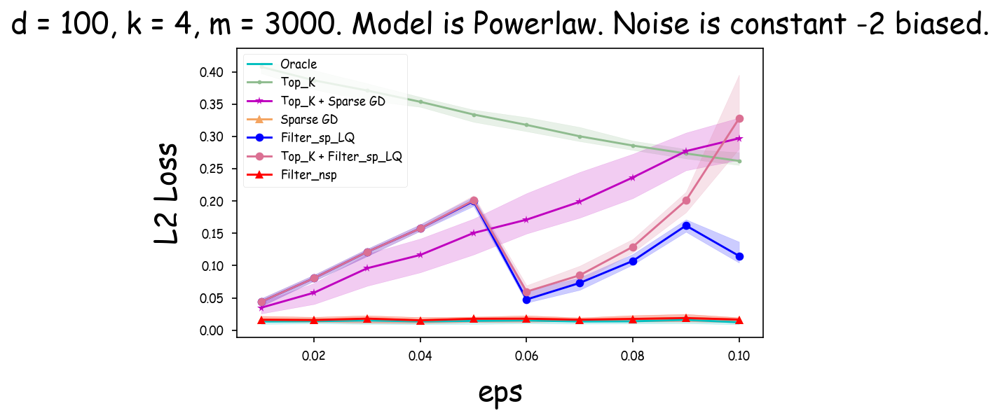

<Figure size 1200x600 with 0 Axes>

In [9]:
"loss vs eps -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-powerlaw.pkl'
outputfilename = 'figs/loss-vs-eps-powerlaw.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Powerlaw. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 Loss'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs eps -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-powerlaw.pkl'
outputfilename = 'figs/loss-vs-eps-powerlaw-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Powerlaw. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 Loss'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs eps -- powerlaw -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-powerlaw.pkl'
outputfilename = 'figs/time-vs-eps-powerlaw.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Gaussian. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs eps -- powerlaw -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.PowerlawModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-powerlaw.pkl'
outputfilename = 'figs/time-vs-eps-powerlaw-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Powerlaw. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)